The goal of this notebook is to show that one can easily play with geographic data, in particular by drawing maps or graphs.

In [1]:
import pandas as pd # go-to library for data analysis and manipulation
import matplotlib.pyplot as plt # static graphs
import matplotlib.patches as mpatches
from mpl_toolkits.basemap import Basemap # little bit trick to install, refer to readme if you have any problems to install it
import pycountry # # allows mapping of country names to ISO names and vice versa
import plotly.express as px # interactive graphs

# I - Read and prepare data

In [2]:
terror = pd.read_csv('data/globalterrorismdb_0718dist.csv', encoding='ISO-8859-1')
terror.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day','country_txt':'Country','region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target','nkill':'Killed','nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type','weaptype1_txt':'Weapon_type','motive':'Motive'}, inplace=True)
terror = terror[['Year','Month','Day','Country','Region','city','latitude','longitude','AttackType','Killed','Wounded','Target','Summary','Group','Target_type','Weapon_type','Motive']]
terror['Casualties'] = terror['Killed'] + terror['Wounded']
terror.head(3)

/Users/aurelien.massiot/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (4,6,31,33,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,Year,Month,Day,Country,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive,Casualties
0,1970,7,2,Dominican Republic,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,Julio Guzman,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,1.0
1,1970,0,0,Mexico,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,"Nadine Chaval, daughter",NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,0.0
2,1970,1,0,Philippines,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,Employee,NaN,Unknown,Journalists & Media,Unknown,NaN,1.0


In [3]:
print(f"Country with the highest number of terrorist attacks: {terror['Country'].value_counts().index[0]}")
print(f"Region with the highest number of terrorist attacks: {terror['Region'].value_counts().index[0]}")
print(f"Maximum number of people killed in an attack: {terror['Killed'].max()}")

Country with the highest number of terrorist attacks: Iraq
Region with the highest number of terrorist attacks: Middle East & North Africa
Maximum number of people killed in an attack: 1570.0


Thanks to PyCountry, we will retrieve the ISO codes of the countries to be able to use them in our maps.

In [4]:
map_countries = {}
for country in pycountry.countries:
    map_countries[country.name] = country.alpha_3
    
inv_map_countries = {v: k for k, v in map_countries.items()}

terror['iso_alpha'] = [map_countries.get(country, 'Unknown code') for country in terror['Country']]

We define other mappings, which will allow us to obtain:
- a region from a country (and vice versa)
- a continent from a region (and vice versa)

This will be of use to us a bit later when we aggregate the data.

In [5]:
map_region_country = terror.groupby('Region')['Country'].apply(lambda x: list(set(x.tolist()))).to_dict()
inv_map_region_country = {value: key for key in map_region_country for value in map_region_country[key]}

In [6]:
map_continent_region = {'Asia': ['South Asia', 'East Asia', 'Central Asia', 'Southeast Asia'],
                        'Europe': ['Eastern Europe', 'Western Europe'],
                        'Africa': ['Middle East & North Africa', 'Sub-Saharan Africa'],
                        'South America': ['South America', 'Central America & Caribbean'],
                        'North America': ['North America'],
                        'Oceania': ['Australasia & Oceania']}
inv_map_continent_region = {value: key for key in map_continent_region for value in map_continent_region[key]}

# II - Animated graphs

## 1 - Beautiful maps

For this graph, we aggregate the number of deaths per country (iso_alpha), then we display everything on a world map.
Each point, more or less large, represents the number of deaths by country in all years, by attacks.

In [7]:
df_terror_sum_by_region = terror[['Killed','iso_alpha']].groupby('iso_alpha').sum()
df_terror_sum_by_region.reset_index(inplace=True)
df_terror_sum_by_region['Country'] = [inv_map_countries.get(iso_alpha, 'Unknown code') for iso_alpha in df_terror_sum_by_region['iso_alpha']]
df_terror_sum_by_region.head()

,iso_alpha,Killed,Country
0,AFG,39384.0,Afghanistan
1,AGO,3043.0,Angola
2,ALB,42.0,Albania
3,AND,0.0,Andorra
4,ARE,123.0,United Arab Emirates


In [8]:
fig = px.scatter_geo(df_terror_sum_by_region, 
                     locations='iso_alpha', 
                     color='Country',
                     hover_name='Country', 
                     size='Killed',
                     projection='natural earth',
                     title='Number of deaths by country (1970-2016)')
fig.show()

With Plotly Express, you can easily animate the graphs; here, we will perform the same aggregation as before but this time adding Year in the groupby clause, which allows us to use the year at each time step.

In [9]:
df_terror_sum_by_region_by_year = terror[['Killed', 'Wounded', 'Casualties', 'iso_alpha', 'Year']].groupby(['iso_alpha', 'Year']).sum()
df_terror_sum_by_region_by_year.reset_index(inplace=True)

The following 3 lines allow us, thanks to the mapping carried out at the beginning of the notebook, to find the countries, regions and continents from the ISO code.

In [10]:
df_terror_sum_by_region_by_year['Country'] = [inv_map_countries.get(iso_alpha, 'Unknown code') for iso_alpha in df_terror_sum_by_region_by_year['iso_alpha']]
df_terror_sum_by_region_by_year['Region'] = [inv_map_region_country.get(country, 'Unknown code') for country in df_terror_sum_by_region_by_year['Country']]
df_terror_sum_by_region_by_year['Continent'] = [inv_map_continent_region.get(region, 'Unknown code') for region in df_terror_sum_by_region_by_year['Region']]

Finally, we sort the data by year.

In [11]:
df_terror_sum_by_region_by_year = df_terror_sum_by_region_by_year.sort_values('Year')
df_terror_sum_by_region_by_year.head()

,iso_alpha,Year,Killed,Wounded,Casualties,Country,Region,Continent
149,AUS,1970,0.0,0.0,0.0,Australia,Australasia & Oceania,Oceania
2454,PHL,1970,41.0,13.0,54.0,Philippines,Southeast Asia,Asia
1228,GTM,1970,2.0,0.0,2.0,Guatemala,Central America & Caribbean,South America
1179,GRC,1970,2.0,0.0,2.0,Greece,Western Europe,Europe
1571,ITA,1970,0.0,0.0,0.0,Italy,Western Europe,Europe


In [12]:
fig = px.scatter_geo(df_terror_sum_by_region_by_year, 
                     locations='iso_alpha', 
                     color='Country',
                     hover_name='Country', 
                     size='Killed', 
                     animation_frame='Year',
                     projection='natural earth')
fig.show()

We can change the representation this time using a choropleth map, which this time will color all the countries according to the number of deaths.

In [13]:
fig = px.choropleth(df_terror_sum_by_region_by_year, 
                    locations='iso_alpha',
                    hover_name='Country', 
                    color='Killed', 
                    animation_frame='Year',
                    projection='natural earth',
                    range_color=[0, df_terror_sum_by_region_by_year['Killed'].max()],
                    color_continuous_scale='Reds')
fig.show()

The previous graph is good, but we can do better on the scale, in particular by displaying the values only when there has been at least one death and by grouping the countries where there have been 1000 deaths and more .

In [14]:
fig = px.choropleth(df_terror_sum_by_region_by_year, 
                    locations='iso_alpha',
                    hover_name='Country', 
                    color='Killed', 
                    animation_frame='Year',
                    projection='natural earth',
                    range_color=[1, 1000],
                    color_continuous_scale='Reds')
fig.show()

You can also change the type of projection to see that the earth is round :-).

In [15]:
fig = px.choropleth(df_terror_sum_by_region_by_year, 
                    locations='iso_alpha',
                    hover_name='Country', 
                    color='Killed', 
                    animation_frame='Year',
                    projection='orthographic',
                    range_color=[1, 1000],
                    color_continuous_scale='Reds')
fig.show()

fter Plotly Express, it is also possible to use Matplotlib's Basemap to create highly customizable maps.
In particular, you can easily change the type of projection used, the longitudes and latitudes used to project the map, the colors of the countries and the oceans (you can add relief, for example).

In the following example, we use the cylindrical Miller projection, which is similar to the Mercator projection but deforms the poles less. A point is displayed for each event, red if it has killed less than 50 and yellow if it has killed less than 50.

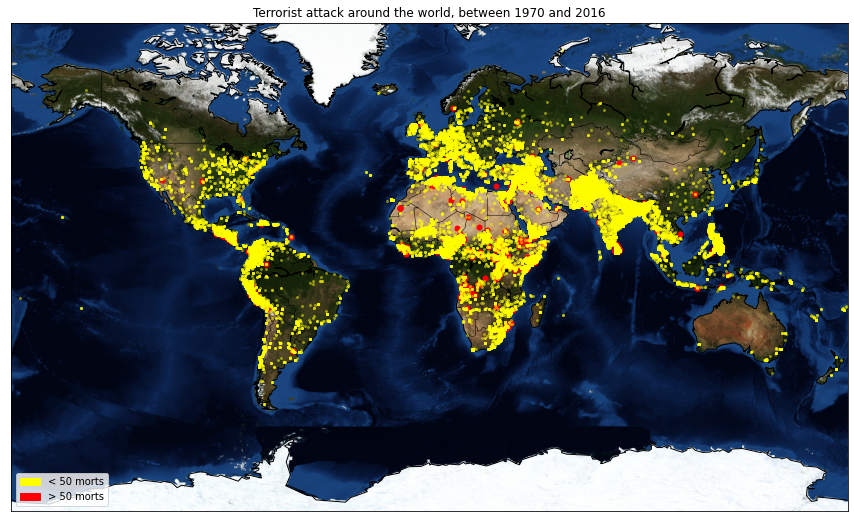

In [24]:
m3 = Basemap(projection='mill', 
             llcrnrlat=-80,
             urcrnrlat=80, 
             llcrnrlon=-180,
             urcrnrlon=180,
             lat_ts=20,
             resolution='c',
             lat_0=True,
             lat_1=True)

n_high_killed = 50

lat_high_killed = list(terror[terror['Killed']>=n_high_killed].latitude)
lon_high_killed =list(terror[terror['Killed']>=n_high_killed].longitude)
x_high_killed, y_high_killed = m3(lon_high_killed, lat_high_killed)
m3.plot(x_high_killed, y_high_killed, 'go', markersize=5, color='red')

lat_low_killed = list(terror[terror['Killed']<n_high_killed].latitude)
lon_low_killed = list(terror[terror['Killed']<n_high_killed].longitude)
x_high_killed, y_high_killed=m3(lon_low_killed, lat_low_killed)
m3.plot(x_high_killed, y_high_killed, 'go', markersize=2, color='yellow', alpha=0.4)

m3.drawcoastlines()
m3.drawcountries()
#m3.fillcontinents(lake_color='aqua')
#m3.drawmapboundary(fill_color='aqua')
fig = plt.gcf()
fig.set_size_inches(15, 9)
plt.title('Terrorist attack around the world, between 1970 and 2016')
plt.legend(loc='lower left', 
           handles=[mpatches.Patch(color='yellow', label=f'< {n_high_killed} morts'),
                    mpatches.Patch(color='red',label=f'> {n_high_killed} morts')])
m3.bluemarble()
plt.show()

## 2 - Beautiful graphs

This histogram displays the total number of deaths, by type of attack.

In [25]:
fig = px.histogram(terror, 
                   x='AttackType', 
                   y='Killed',
                   color='AttackType',
                   histfunc='sum',
                   title="Number of deaths by type of attack"
                  )
fig.show()

Here, we will animate a graph according to the years, which will represent the evolution of the number of deaths and injuries by continent.
Note: To make the graph more readable, the maximum tick on the x-axis and y-axis is equal to half of the maximum of the domain.

In [26]:
fig = px.scatter(df_terror_sum_by_region_by_year, 
                 x='Wounded', 
                 y='Killed', 
                 animation_frame='Year', 
                 animation_group='Country',
                 size='Casualties', 
                 color='Continent', 
                 hover_name='Country', 
                 facet_col='Continent',
                 size_max=45, 
                 range_x=[0, df_terror_sum_by_region_by_year['Wounded'].max()/2], 
                 range_y=[0, df_terror_sum_by_region_by_year['Killed'].max()/2],
                 title='Evolution of the number of injuries and deaths by continent')
         
fig.show()

Here, we try to display curves of the number of deaths by country, each color representing the continent of the country.

In [27]:
fig = px.line(df_terror_sum_by_region_by_year, 
              x='Year', 
              y='Killed', 
              color='Continent', 
              line_group='Country', 
              hover_name='Country',
              line_shape='spline', 
              render_mode='svg',
              title='Evolution of the number of deaths by continent')
fig.show()

The following graph displays the total number of deaths and injuries per country, each color representing the continent of the country; each point therefore represents a country.
There is also a curve which allows, by continent, to determine a linear regression between the wounded and the dead.
Finally, there are on the margins, the violinplots and boxplots, respectively injured and dead.

In [20]:
fig = px.scatter(df_terror_sum_by_region_by_year, 
                 x='Wounded', 
                 y='Killed', 
                 color='Continent', 
                 marginal_x='violin',
                 marginal_y='box', 
                 trendline='ols')
fig.show()

For the histograms and the parallel category graph, we have chosen to filter the dataset with certain types of attacks, regions and weapon types in order to make it readable.

In [21]:
chosen_attack_type = ['Assassination', 'Bombing/Explosion', 'Armed Assault']
chosen_region = ['Middle East & North Africa', 'Sub-Saharan Africa']
chosen_weapon_type = ['Firearms', 'Explosives/Bombs/Dynamite', 'Incendiary']

terror_filtered = terror[terror['AttackType'].isin(chosen_attack_type)]
terror_filtered = terror_filtered[terror_filtered['Region'].isin(chosen_region)]
terror_filtered = terror_filtered[terror_filtered['Weapon_type'].isin(chosen_weapon_type)]

In [28]:
fig = px.histogram(terror_filtered, 
             x='AttackType', 
             y='Killed', 
             color='Weapon_type', 
             barmode='group', 
             facet_row='Region',
             title="Number of deaths by type of attack and weapon, by region of Africa")
fig.show()

In [29]:
fig = px.parallel_categories(terror_filtered,
                             dimensions=['AttackType', 'Region', 'Weapon_type'],
                             color='Year',
                             title="Number of events per year according to type of attack, region and type of weapon")
fig.show()